# Anatomical Magnetic Resonance Imaging (MRI) data

This session will guide you through the steps that one needs to follow in order to understand and work with neuroimaging data. We will cover how this data is obtained and what can be seen from it. NeuroImaging data is sensitive, heavy, complex and, most importantly, collaborative. Thus, it needs to be stored in efficient and standardized forms: the NIFTI and BIDS formats. Unfortunately MR scaners do not produce these types of formats and data usually needs to be semiautomatically transformed in order to meet the aforementioned criteria.

You will also learn what softwares and/or custom codes one can use in order to inspect the images once they are in the correct format. In order to know what can be done with this type of data is perhaps more important to be aware at what you are not looking at. Understanding what is the data showing you is a crucial step prior to digging into the specifics of the data structure and what can be done with it.

Eventually, you will be in a position where you can do what you came here to do... use some machine learning or artificial intelligence methods to unravel what the naked eye might have missed. One of the gold-standard of medical imaging is the segmentation of different structures or lesions that can be seen in the brain. Only after doing a manual segmentation can one see the huge advantage of letting stochastic gradient descent do the heavy work.

The notebook is organized as follows
1.   From the MR scanner to your laptop: DICOM, NIFTI and BIDS
2.   Data and visualization: What do I have? How do I see what I have?
3.   Tissue segmentation: Unsupervised vs supervised methods
4.   Anatomical MRI acquisitions: What am I looking at?
5.   Homework

Just to be on the safe do what you probably already know:
```
conda create -y -n ML4Neuro python=3.11 numpy matplotlib
conda init bash
conda activate ML4Neuro
conda install -c conda-forge jupyterlab
cd /path/to/github/directory
jupyter-lab
```

## 1. From the MR scanner to your laptop: DICOM, NIFTI and BIDS.

The *Digital Imaging and Communications in Medicine* (DICOM) is the standard format for storing and transmitting medical imaging data and information. In this section we will take a look at what this format offers as well as its shortcomings. Ultimately, we need to convert from DICOM to NIFTI and reorganize our data in a way that it's compliant with the BIDS format. This organizational format ensures a correct usage of neuroimaging software increasing the reproducibility and replicability of neuroimaging findings.


In [1]:
!pip install pydicom
import pydicom as dicom
import glob
import matplotlib.pylab as plt
import numpy as np

In [16]:
# Prepare the directory variables
DICOM_subject = 'FCS-02AMC'
DICOM_acq = '4'
DICOM_dir = f'./DICOM-dir/{DICOM_subject}/{DICOM_acq}/' 
slices = sorted(glob.glob(DICOM_dir+'DICOM/*.dcm'))

In [17]:
# Read a single DICOM image
dicom_image = dicom.dcmread(slices[0])
dicom_image

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 198
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: MR Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.3.12.2.1107.5.2.32.35177.3.201011161149402273705572
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.40.0.13.1.1
(0002, 0013) Implementation Version Name         SH: 'dcm4che-2.0'
(0002, 0016) Source Application Entity Title     AE: 'DCMSEND'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'M', 'ND', 'NORM']
(0008, 0012) Instance Creation Date              DA: '20101116'
(0008, 0013) Instance Creation Time              TM: '114942.328000'
(0008, 0016) SOP Class UID  

This is a lot of information, which may or may not be useful depending on the experiment or on the type of paper your are trying to write. Given that ``` dicom_image ``` is a python object, we can access whatever fields we wish. Several acquisition parameters are usually reported in the studies and all of them can easily be accessed through this object. It is common to have the same scanning protocols for all the subjects in the dataset, but sometimes mistakes occur. With this type of software it should be easy to automatize searching schemes in order to stablish whether the protocol was changed during a study.



In [18]:
# What was the Repetition Time of the protocol?
TR = dicom_image.RepetitionTime
print(f"Repetition Time = {TR} (s)")
# What was the Echo Time of the protocol?
ET = dicom_image.EchoTime
print(f"Echo Time = {ET} (s)")
# What was the Type of acquisition?
ACQ_type = dicom_image.SeriesDescription
print(f"Acquisition type: {ACQ_type}")

Repetition Time = 1950 (s)
Echo Time = 2.26 (s)
Acquisition type: MPR_1mm_iso


However, can we acess the data? If so, what is the data exactly?

In [19]:
data = dicom_image.pixel_array
print(f"The shape of the data is: {data.shape}")
print(f"The type of variable is: {type(data)}")
print(data)

The shape of the data is: (256, 256)
The type of variable is: <class 'numpy.ndarray'>
[[ 0  0  0 ...  0  0  0]
 [ 0  2  2 ...  2  1  0]
 [ 0  1  1 ...  1  4  1]
 ...
 [ 0  0  5 ... 13 29 13]
 [ 0  5  6 ... 10  7 21]
 [ 0  7  4 ...  9 21  3]]


**Question:** What are the main differences between acquisition '16' and '4' of the subject with ID 'FCS-02AMC'?

In magnetic resonance imaging (MRI), repetition time (TR), echo time (TE), and acquisition refer to important parameters that are used to control the imaging process and obtain the desired image contrasts.
1.	Repetition Time (TR) is the interval between successive excitation pulses in MRI.
2.	Echo time (TE) is the time between the delivery of the RF pulse and the receipt of the echo signal.
3.	ACQ Type  - a number identifying the single continuous gathering of data over a period of time that resulted in the instance
These parameters are crucial in tailoring the MRI protocol to the type of information needed for diagnosis or research purposes.

For acquisition '16' TR and TE are lower and type of the ACQ is different. 


It is clear that the DICOM format stores a lot of information including the data itself. Yet, what is the data? How can you see what you have stored? And how compact and easy to use is this format when it comes to numerical analyses of the scans?

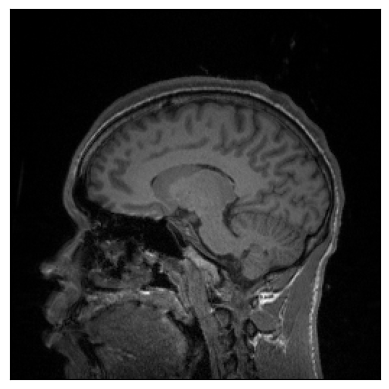

In [20]:
num_to_plot = 1

fig, axes = plt.subplots(num_to_plot, num_to_plot)
if num_to_plot > 1:
  axes = axes.flatten()
  for i, ax in enumerate(axes):
    ax.imshow(
        dicom.dcmread(slices[i]).pixel_array, cmap='gray'
    )
    ax.set_xticks([]), ax.set_yticks([])
else:
  axes.imshow(
      dicom.dcmread(slices[2]).pixel_array, cmap='gray'
  )
  axes.set_xticks([]), axes.set_yticks([])
plt.show()

Ares these images the same? Recall that the brain (or any other organ) is a 3D volume, and current MR scanners take 2D pictures hence they have to move along the head volume capturing *slices* of the subject. The DICOM format stores all these slices together with the corresponding information for each slice (e.g., Window Center). Each slice is stored separately in the acquisition folder (e.g., 16) with a very strange and almost undesciferable name. Furthermore, we can only visualize a single viewing plane that depends on the acquisition parameters. In the former example we could plot the sagital plane straight from the data. Can we do better? Yes!

The *Neuroimaging Informatics Technology Initiative* (NIfTI) format is commonly used brain MR data and it allows to store all the desired information available in the DICOM directory into a single file. Importantly, there is a standard file-naming code that should be taken into consideration: **the FILE-NAME should not be left unattended!** For every subject, a whole DICOM session will be condensed into:

*   a FILE-NAME.nii file containing the data
*   a FILE-NAME.json file containing the aquisition parameters
*   a FILE-NAME.bvec file containing gradient directions
*   a FILE-NAME.bval file containing the gradient strengths

Importantly, the two last files will only appear in the case of difussion MRI acquisitions. For now let's ignore their meaning since we will focus on them in the next laboratory session.

To move from DICOM to NIFTI formats one could build a custom converter. The basics would require a stacking of all slices along a 3rd dimension ensuring that each slice is positioned correctly along the depth axis. A proper json file should also be manually written with the information extracted from the DICOM heather. Evenmore, in the case of diffusion data, the gradient strength and orientation would also need to be decoded from the DICOM heather. Yet, as you can probably imagine, there is a better and faster way to do all this. For now, let's convert the previous DICOM session to NIFTI and see what it looks like.

In [21]:
!pip install dicom2nifti
import dicom2nifti
import os

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 14.9 MB/s eta 0:00:00m eta 0:00:010:0101
  Obtaining dependency information for scipy from https://files.pythonhosted.org/packages/ef/1b/7538792254aec6850657d5b940fd05fe60582af829ffe40d6c054f065f34/scipy-1.11.3-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.0/13.0 MB 32.0 MB/s eta 0:00:00m eta 0:00:010:0101
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.4/36.4 MB 2.9 MB/s eta 0:00:00m eta 0:00:010:00:01m


In [22]:
T1_DICOM = f'./DICOM-dir/{DICOM_subject}/4/'
DTI_DICOM = f'./DICOM-dir/{DICOM_subject}/16/'

NIFTI_dir = f'./subject_{DICOM_subject}_NIFTI_dir/pydicom/'
if not os.path.exists(NIFTI_dir):
  os.makedirs(NIFTI_dir)

# Apply conversion
dicom2nifti.convert_directory(T1_DICOM, NIFTI_dir, compression=True)
dicom2nifti.convert_directory(DTI_DICOM, NIFTI_dir, compression=True)

Where are the ```.json``` files? Have we lied to you before? No!

***Exercise*** *Find a way to obtain the missing ```.json``` with the ```pydicom``` library. The documentation can be found [here](https://dicom2nifti.readthedocs.io/en/latest/).


In [23]:
# TODO: Exercise

Have you found a way to do so? If you did, please show it to us. If you didn't succeed do not worry too much because we don't know how to do it either.

Besides, you may have noticed that the FILE-NAME is a strange combination of letters and numbers. In fact, if you try to convert other dicom series you will notice how the name is identical. While this indicates that the protocol for every subject was kept the same, it can be problematic when it comes to identifying subjects and working with the whole dataset.The proper way to do so is to work with LINUX/MACOS, Windows is not really an option: 

![windows](./windows_support.PNG)

Once you have proper operating system you can proceed. Alternatively there are virtual machines or docker containers with most of the necessary neuroimaging software which might work properly on Windows: [Neurodesk](https://www.neurodesk.org/) for example. Anyhow, the best way to convert between formats is using [dmc2niix](https://manpages.ubuntu.com/manpages/jammy/en/man1/dcm2niix.1.html).

In [24]:
!pip install dcm2niix # This will install the software package but will only be available within the current conda environment
# sudo apt install dcm2niix will install it system wide in Linux (requires sudo password)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 451.4/451.4 kB 5.0 MB/s eta 0:00:004.1 MB/s eta 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Obtaining dependency information for miutil[web] from https://files.pythonhosted.org/packages/8e/75/b4639b18b42d6c8b744b47c3f66c2efd029e7198beed88870c7cb9201f0a/miutil-0.12.0-py3-none-any.whl.metadata
  Obtaining dependency information for tqdm>=4.40.0 from https://files.pythonhosted.org/packages/00/e5/f12a80907d0884e6dff9c16d0c0114d81b8cd07dc3ae54c5e962cc83037e/tqdm-4.66.1-py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.3/78.3 kB 8.4 MB/s eta 0:00:00
  Created wheel for dcm2niix: filename=dcm2niix-1.0.20220715-py3-none-any.whl size=12219 sha256=cca315e48dacb98fa629a8a3f7e979580bbb52296ff76dd50ecb7ebd7b8d840f
  Stored in directory: /home/kamila/.cac

In [25]:
%%bash

DICOM_dir="./DICOM-dir/FCS-02AMC/"
NIFTI_dir_dcm2niix="./subject_FCS-02AMC_NIFTI_dir/dcm2niix/"
mkdir $NIFTI_dir_dcm2niix

dcm2niix -o $NIFTI_dir_dcm2niix $DICOM_dir

100%|██████████| 856k/856k [00:00<00:00, 9.38MB/s]
Extracting: 100%|██████████| 2.27M/2.27M [00:00<00:00, 157MB/s]


Chris Rorden's dcm2niiX version v1.0.20230411  (JP2:OpenJPEG) (JP-LS:CharLS) GCC8.4.0 x86-64 (64-bit Linux)
Found 240 DICOM file(s)
Convert 176 DICOM as ./subject_FCS-02AMC_NIFTI_dir/dcm2niix/FCS-02AMC_MPR_1mm_iso_20101116114152_4 (256x256x176x1)
Convert 64 DICOM as ./subject_FCS-02AMC_NIFTI_dir/dcm2niix/FCS-02AMC_dti_63dir_2mm_iso_1of2_20101116114152_16 (128x128x64x64)
Conversion required 0.783484 seconds (0.673825 for core code).


As you can see the ```.json``` files are automatically generated and the conversion is much faster: we converted a whole subject in less than 0.5s. It is recommended to zip the .nii files using the ```-z``` flag. Furthermore, you have more control on the output name if you use the ```-f``` flag. You can customize your name in any way you prefer so that you can easily identify the files you converted.

In [60]:
%%bash

DICOM_dir="./DICOM-dir/FCS-02AMC/"
NIFTI_dir_dcm2niix_naming="./subject_FCS-02AMC_NIFTI_dir/dcm2niix-naming/"
mkdir $NIFTI_dir_dcm2niix_naming

dcm2niix -o $NIFTI_dir_dcm2niix_naming -f %n--%p--%t $DICOM_dir 

Chris Rorden's dcm2niiX version v1.0.20230411  (JP2:OpenJPEG) (JP-LS:CharLS) GCC8.4.0 x86-64 (64-bit Linux)
Found 240 DICOM file(s)
Convert 176 DICOM as ./subject_FCS-02AMC_NIFTI_dir/dcm2niix-naming/FCS_002_AMC--MPR_1mm_iso--20101116114152 (256x256x176x1)
Convert 64 DICOM as ./subject_FCS-02AMC_NIFTI_dir/dcm2niix-naming/FCS_002_AMC--dti_63dir_2mm_iso_1of2--20101116114152 (128x128x64x64)
Conversion required 0.857741 seconds (0.836095 for core code).


In [61]:
!pip install bids-validator
from bids_validator import BIDSValidator
BIDS_dir = './subject_FCS-02AMC_NIFTI_dir/dcm2niix-naming'
BIDSValidator().is_bids(BIDS_dir)

False

Don't worry you don't have to remember everything we say. Doing research involves a lot of google search queries, so one basically becomes very profficient and precise about the words used in the search bar. Here are a couple of useful links that might come in handy: [BIDS](https://bids.neuroimaging.io/) and [dcm2niix](https://manpages.ubuntu.com/manpages/jammy/en/man1/dcm2niix.1.html).

***Exercise***: *Try to convert the whole DICOM directory to NIFTI files and reorganize them in a way that is BIDS compliant. You can reorganize them manually or automatically using regular expressions and the ```os``` library. To be sure the final dataset agrees with the minimum BIDS requirements you can use any of the two following options:*

1. The python interface (although it is not the best): ```pip install bids-validator```
2. The web interface [bids-validator](http://bids-standard.github.io/bids-validator/)

Be sure to include all the necessary information when converting your dicom files so that you can identify them properly. 

![bids](./BIDS.jpg)

In [82]:
# TODO: Exercise

dicom_source_dir = "./DICOM-dir"
subdirectories = [d for d in os.listdir(dicom_source_dir) if os.path.isdir(os.path.join(dicom_source_dir, d))]
subdirectories

['fcs-01acm', 'fcs-06amc2', 'fcs-07acm', 'FCS-02AMC', 'fcs-07amc2']

In [66]:
import subprocess

In [83]:
for subdir in subdirectories:
    dicom_subdir = os.path.join(dicom_source_dir, subdir)
    print(dicom_subdir)
    nifti_target_dir = f"./BIDS-dir/subject_{subdir}_NIFTI_dir/{subdir}"
    print(nifti_target_dir)
    os.makedirs(nifti_target_dir, exist_ok=True)
    command = f'dcm2niix -o {nifti_target_dir} -f %n--%p--%t {dicom_subdir}'
    subprocess.run(command, shell=True, check=True)

./DICOM-dir/fcs-01acm
./BIDS-dir/subject_fcs-01acm_NIFTI_dir/fcs-01acm
Chris Rorden's dcm2niiX version v1.0.20230411  (JP2:OpenJPEG) (JP-LS:CharLS) GCC8.4.0 x86-64 (64-bit Linux)
Found 176 DICOM file(s)
Convert 176 DICOM as ./BIDS-dir/subject_fcs-01acm_NIFTI_dir/fcs-01acm/fcs-01acm--MPR_1mm_iso--20101123111604 (256x256x176x1)
Conversion required 0.260541 seconds (0.246183 for core code).
./DICOM-dir/fcs-06amc2
./BIDS-dir/subject_fcs-06amc2_NIFTI_dir/fcs-06amc2
Chris Rorden's dcm2niiX version v1.0.20230411  (JP2:OpenJPEG) (JP-LS:CharLS) GCC8.4.0 x86-64 (64-bit Linux)
Found 240 DICOM file(s)
Convert 64 DICOM as ./BIDS-dir/subject_fcs-06amc2_NIFTI_dir/fcs-06amc2/FCS_006_AMC2--dti_63dir_2mm_iso_1of2--20110208114139 (128x128x64x64)
Convert 176 DICOM as ./BIDS-dir/subject_fcs-06amc2_NIFTI_dir/fcs-06amc2/FCS_006_AMC2--MPR_1mm_iso--20110208114139 (256x256x176x1)
Conversion required 0.843739 seconds (0.824737 for core code).
./DICOM-dir/fcs-07acm
./BIDS-dir/subject_fcs-07acm_NIFTI_dir/fcs-07acm

In [94]:
bids_dir = "./BIDS-dir"
subdirectories = [d for d in os.listdir(bids_dir) if os.path.isdir(os.path.join(bids_dir, d))]
subdirectories
validator = BIDSValidator()
for subdir in subdirectories:
    nifti_target_dir = f"./BIDS-dir/{subdir}"
    subdirectories_inside = [d for d in os.listdir(nifti_target_dir) if os.path.isdir(os.path.join(nifti_target_dir, d))]
    for subsubdir in subdirectories_inside :
        subdir_path = os.path.join(nifti_target_dir, subsubdir)
        is_bids = validator.is_bids(subdir_path)
        if is_bids:
            print(f"Directory {subdir_path} is a valid BIDS dataset.")
        else:
            print(f"Directory {subdir_path} is not a valid BIDS dataset.")

Directory ./BIDS-dir/subject_fcs-07amc2_NIFTI_dir/fcs-07amc2 is not a valid BIDS dataset.
Directory ./BIDS-dir/subject_fcs-07acm_NIFTI_dir/fcs-07acm is not a valid BIDS dataset.
Directory ./BIDS-dir/subject_fcs-06amc2_NIFTI_dir/fcs-06amc2 is not a valid BIDS dataset.
Directory ./BIDS-dir/subject_FCS-02AMC_NIFTI_dir/FCS-02AMC is not a valid BIDS dataset.
Directory ./BIDS-dir/subject_fcs-01acm_NIFTI_dir/fcs-01acm is not a valid BIDS dataset.


Sometimes, not all the data is available or useful to us. However, some files are required in order to have a more transparent and ready-to-use dataset. Remember, people are busy so you need to make things friendly for the user. Transparency and replicability are also encouraged even jeopardizing your own publication rates. For your own personal reasons or because the experiment demands it, you can also add a .bidsignore file pointing to files or directories that could be useful. The rationale is the same as the typical .gitignore file. For example, in lesion studies, it might be useful to have a directory with all the lesion masks even if its existence is not contemplated in the BIDS formatting.

**Question:** What files are you missing? What information should these files have?

***Optional exercise:*** *Add the necessary files (invent data if necessary) so that your directory complies with the validator's demands.*

To understand the advantages that the NIFTI and BIDS formats offer it is enough to install and import a single python library. [NiBabel](https://nipy.org/nibabel/) The BIDS-dir folder has already some subjects with the correct organization. Feel free to take a look or use the one you created in the last step.

In [95]:
!pip install nibabel
import nibabel as nib

In [103]:
nifti = "../Data4Labs/BIDS-dir/sub-CON01/ses-control/anat/sub-CON01_ses-control_T1w.nii.gz"
img1 = nib.load(nifti)
header1, affine1, data1 = img1.header, img1.affine, img1.get_fdata()

Nibabel loads all the information present in the NIFTI file onto a python object with three attributes:

1. The **nifti header** contains all the information necessary to interpret the data. It can be used to quickly inspect the number of dimensions, the voxel size, the orientation of the image, ... As opposed to the PyDicom object, the header in NiBabel is a dictionary.

In [104]:
print(header1)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 176 256 256   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [1.   1.   1.   1.   1.95 0.   0.   0.  ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'TE=2.3;Time=111930.158;phase=1'
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : -0.12108318
quatern_c       : 0.027722394
quatern_d       : -0.04943511
qoffset_x       : -107.91809
qoffset_y       : -11

2. The **nifti affine** is a 4x4 matrix that encodes the spatial interpretation of the data. Each voxel $(i,j,k)$ in the data represents the MR signal present in a given point in space $(x,y,z)$; thus, the affine is a transformation between voxel space and scanner space. Be sure to check [this](https://nipy.org/nibabel/coordinate_systems.html) very good documentation. At the end of section 3 we will discuss a bit more the concept of the image affine.

In [105]:
print(affine1)

[[ 9.93575573e-01  9.12692249e-02  6.69185743e-02 -1.07918091e+02]
 [-1.04696110e-01  9.65790093e-01  2.37251490e-01 -1.17787430e+02]
 [-4.29755449e-02 -2.42733330e-01  9.69140649e-01 -5.83147583e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


3. The **data** is numpy array where each entry is the value of the reconstructed MR signal. This data however cannot be naively loaded and interpreted without any sort of spatial information.

In [106]:
print(f"Type: {type(data1)}")
print(f"Shape: {data1.shape}")
print(f"Data:\n {data1}")

Type: <class 'numpy.ndarray'>
Shape: (176, 256, 256)
Data:
 [[[ 8.  4.  2. ...  1.  1.  0.]
  [ 6.  4.  6. ...  4.  2.  0.]
  [ 5.  8.  9. ...  0.  3.  0.]
  ...
  [ 6.  9.  1. ...  3.  2.  0.]
  [ 3.  5.  9. ...  4.  2.  0.]
  [ 0.  0.  0. ...  0.  0.  0.]]

 [[ 5.  3. 10. ...  3.  2.  0.]
  [ 9.  1.  4. ...  0.  2.  0.]
  [ 1.  6.  6. ...  3.  5.  0.]
  ...
  [ 7.  2.  0. ...  1.  1.  0.]
  [ 5.  7.  4. ...  4.  0.  0.]
  [ 0.  0.  0. ...  0.  0.  0.]]

 [[ 7.  7.  9. ...  2.  1.  0.]
  [ 0.  1. 10. ...  2.  1.  0.]
  [ 5.  4.  6. ...  3.  1.  0.]
  ...
  [14.  4. 14. ...  0.  3.  0.]
  [ 7.  1.  5. ...  4.  3.  0.]
  [ 0.  0.  0. ...  0.  0.  0.]]

 ...

 [[13. 16.  5. ...  4.  4.  0.]
  [21. 12. 19. ...  2.  5.  0.]
  [ 3.  4. 11. ...  3.  4.  0.]
  ...
  [ 7.  0. 10. ...  4.  3.  0.]
  [14.  8. 11. ...  2.  2.  0.]
  [ 0.  0.  0. ...  0.  0.  0.]]

 [[ 1.  3.  5. ...  8.  5.  0.]
  [ 3. 10.  4. ... 10.  5.  0.]
  [12.  9. 17. ...  6.  3.  0.]
  ...
  [ 1.  7. 11. ...  0.  2.  0.]


Of course, if you overwrite any of these three attributes you can save a new file with the new data. You can do that by simply typing: ```nib.save(nib.Nifti1Header(new_data, new_affine, new_header), new_file_name)```. However, overwiting any of these things without clear knowledge of what you are doing (specially for the header and the affine) could have disastrous consequences. Therefore, it is good practice to use dedicated neuroimaging softwares for certain operations with the data.

## 2. Data visualization: What do I have? How do I see what I have?

As you may have realized, neuroimaging data is complex. Each image has a lot of information that allows any person and/or software to interpret the data correctly. Besides being out of scope, there is not enough time in 1.5h to cover all the technical details around the NIFTI images. Yet, we are now in a position to start taking a proper look into them and, hopefully, provide a comprehensive overview.

Let's start by plotting one scan in the simplest form possible (e.g., the one we have already loaded in memory). Have in mind that each image is a 3D **volume** so we will have to plot slices. 

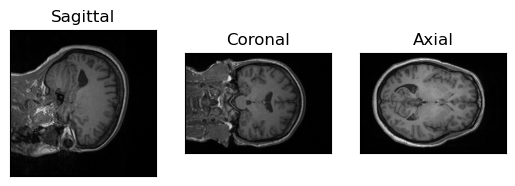

In [108]:
fig, ax = plt.subplots(1,3)
ax[0].imshow(data1[60,...], cmap='gray')
ax[0].set_xticks([]), ax[0].set_yticks([]), ax[0].set_title("Sagittal")

ax[1].imshow(data1[:,125,:], cmap='gray')
ax[1].set_xticks([]), ax[1].set_yticks([]), ax[1].set_title("Coronal")

ax[2].imshow(data1[...,125], cmap='gray')
ax[2].set_xticks([]), ax[2].set_yticks([]), ax[2].set_title("Axial")
plt.show()

A faster option is provided by the attributes of the nibabel oject but it does not allow control over which planes to show.

<OrthoSlicer3D: ../Data4Labs/BIDS-dir/sub-CON01/ses-control/anat/sub-CON01_ses-control_T1w.nii.gz (176, 256, 256)>

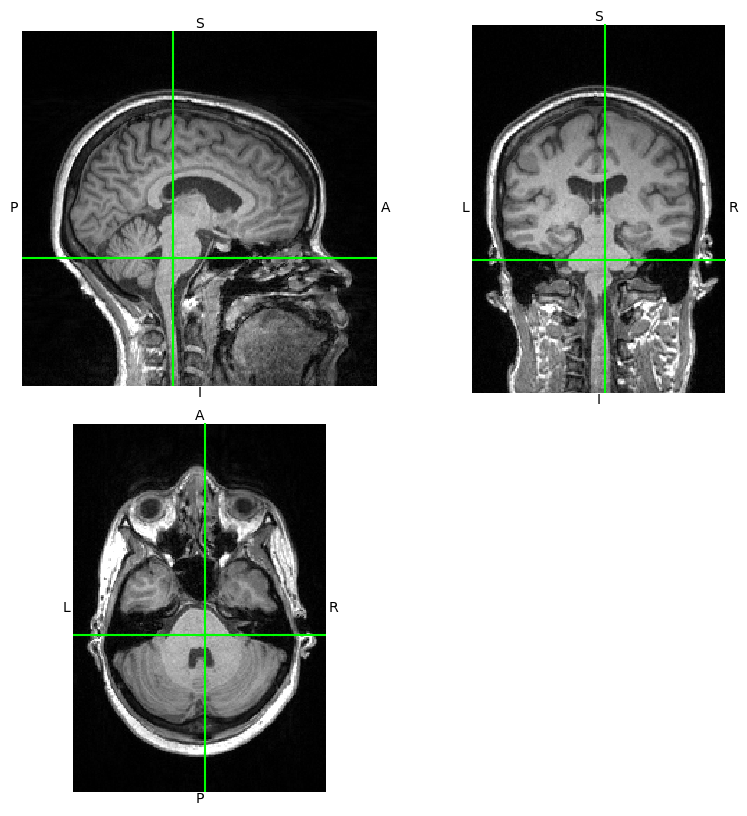

In [109]:
img1.orthoview()

The first advantage of matplotlib is the control that we have over which plane we wish to show. We can rotate the numpy array, transpose it, select which planes to show, ... something we were not able to do with a DICOM series (i.e., a list of 2D slices). The obvious advantage of using the ```orthoview()``` method is that it is very fast, so it would be useful for quickly inspecting the images. Yet, we can do better with [Nilearn](https://nilearn.github.io/stable/index.html). More specifically, if your intention is to simply visualize a nifti image the [view_image](https://nilearn.github.io/dev/modules/generated/nilearn.plotting.view_img.html) function will output an interactive plot of your scan. The function offers many versatile arguments which may be worth being familiar with. 

In [110]:
!pip install nilearn
from nilearn import plotting

  Obtaining dependency information for nilearn from https://files.pythonhosted.org/packages/d3/6d/f9e6f3e38bf6d8d2986c6a426f69f3b45191367383494a515f45dd748692/nilearn-0.10.2-py3-none-any.whl.metadata
  Obtaining dependency information for joblib>=1.0.0 from https://files.pythonhosted.org/packages/10/40/d551139c85db202f1f384ba8bcf96aca2f329440a844f924c8a0040b6d02/joblib-1.3.2-py3-none-any.whl.metadata
  Obtaining dependency information for lxml from https://files.pythonhosted.org/packages/ed/62/ffc30348ae141f69f9f23b65ba769db7ca209856c9a9b3406279e0ea24de/lxml-4.9.3-cp311-cp311-manylinux_2_28_x86_64.whl.metadata
  Obtaining dependency information for pandas>=1.1.5 from https://files.pythonhosted.org/packages/de/ce/b5d9c7ce1aaf9023b823c81932a50cd5e8f407198a696b0d1c6025a40b03/pandas-2.1.1-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
  Obtaining dependency information for scikit-learn>=1.0.0 from https://files.pythonhosted.org/packages/8f/87/5969092159207f583481ad80a0

/home/kamila/anaconda3/envs/ML4Neuro/lib/python3.11/site-packages/nilearn/image/resampling.py:591: UserWarning: Casting data from int32 to float32
  warnings.warn(f"Casting data from {data.dtype.name} to {aux}")



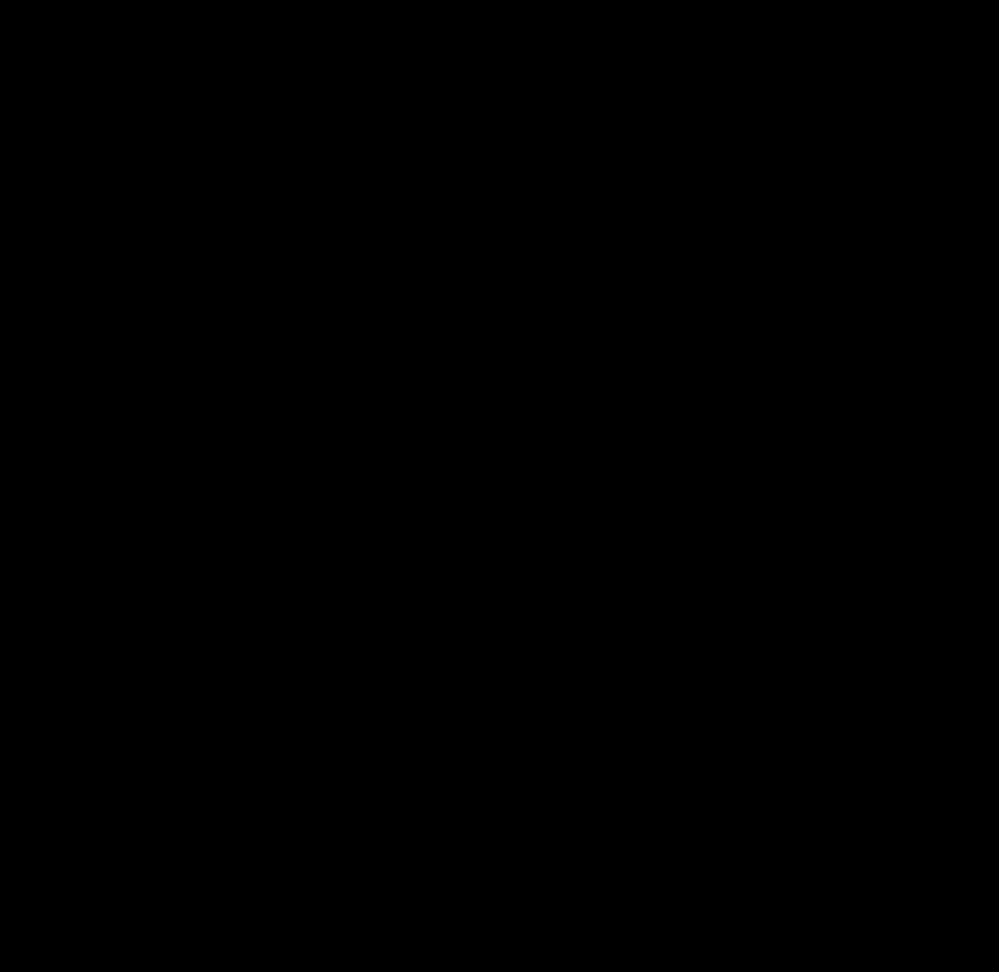
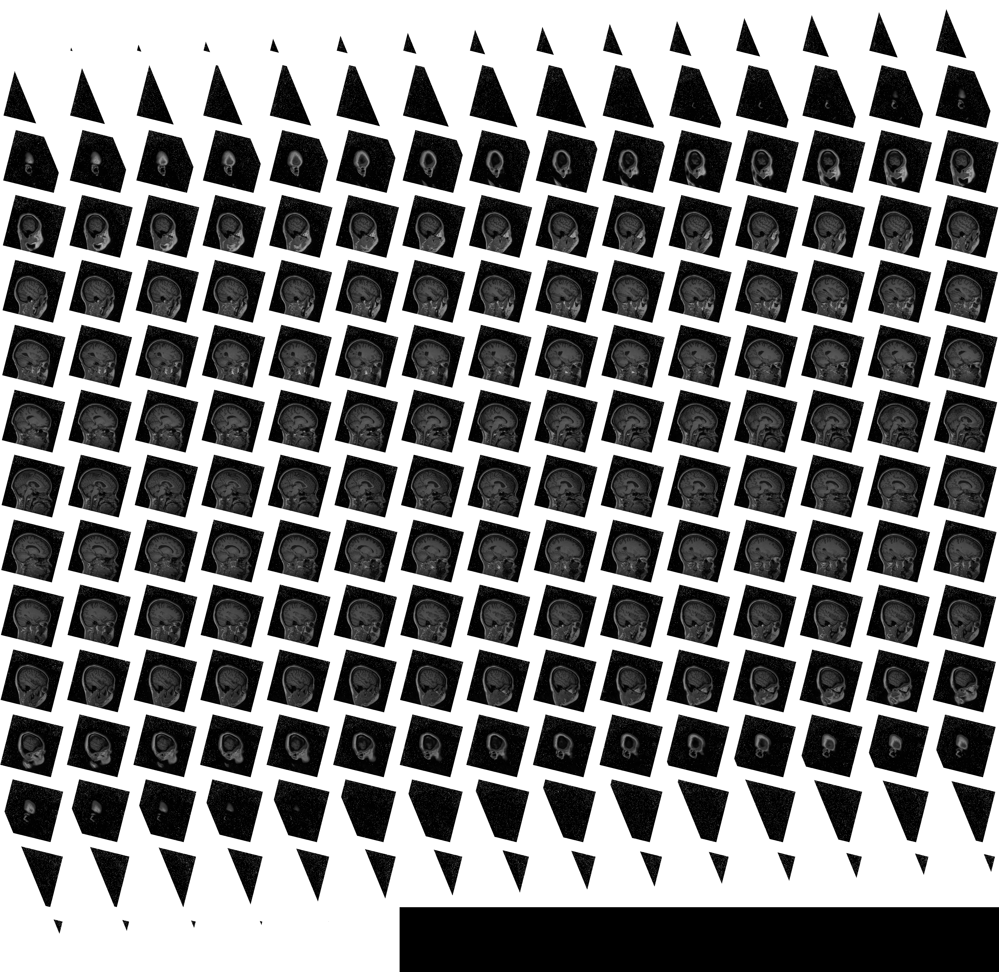

In [111]:
plotting.view_img(
    img1, bg_img=False, colorbar=False, cmap='gray', symmetric_cmap=False
)

**Question:** Why is nilearn using the NIFTI object instead of just the numpy array?

This way of plotting images offers the posisbility of overlaying two different data points (e.g., scans from two different subjects). In other type of experiments, where some statistical procedures would have allowed us to identify active parts of the brain in certain conditions, the same function could be used to overlay the brain and its activity. For now, let's simply overlay two images to check the correspondance between them.

/home/kamila/anaconda3/envs/ML4Neuro/lib/python3.11/site-packages/numpy/core/fromnumeric.py:771: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/kamila/anaconda3/envs/ML4Neuro/lib/python3.11/site-packages/nilearn/image/resampling.py:591: UserWarning: Casting data from int32 to float32
  warnings.warn(f"Casting data from {data.dtype.name} to {aux}")



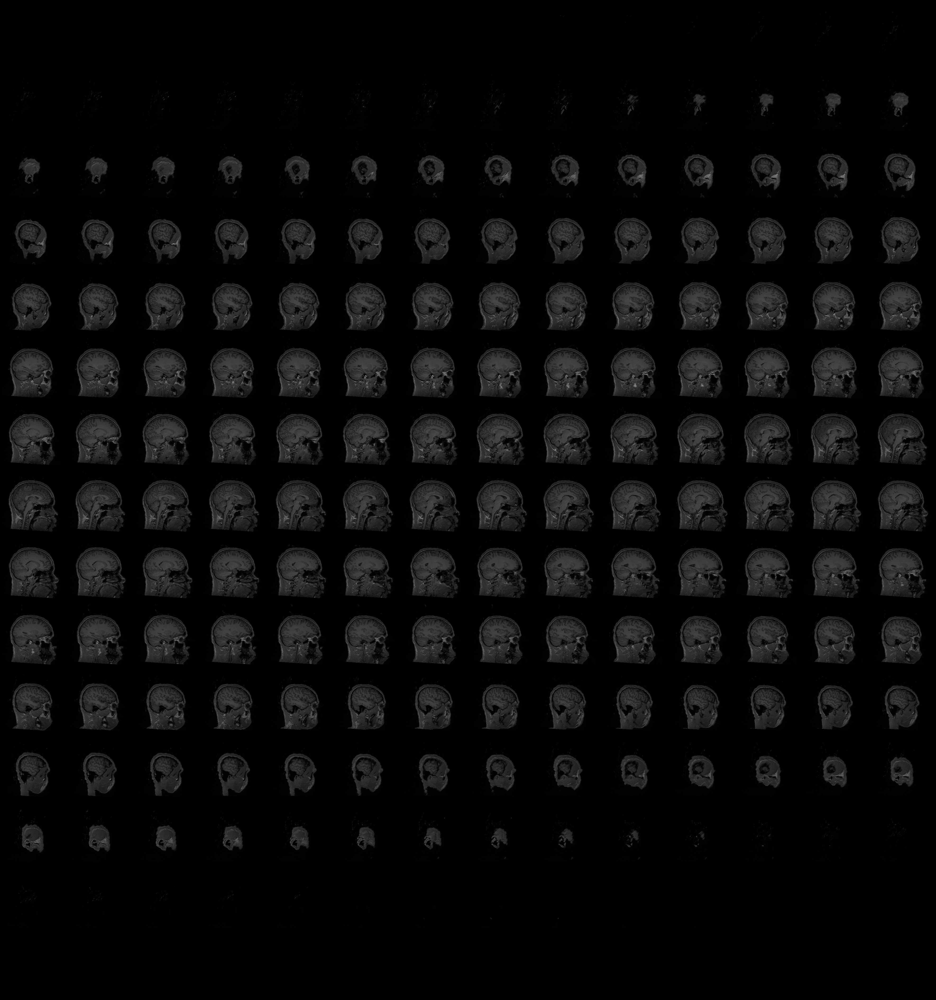
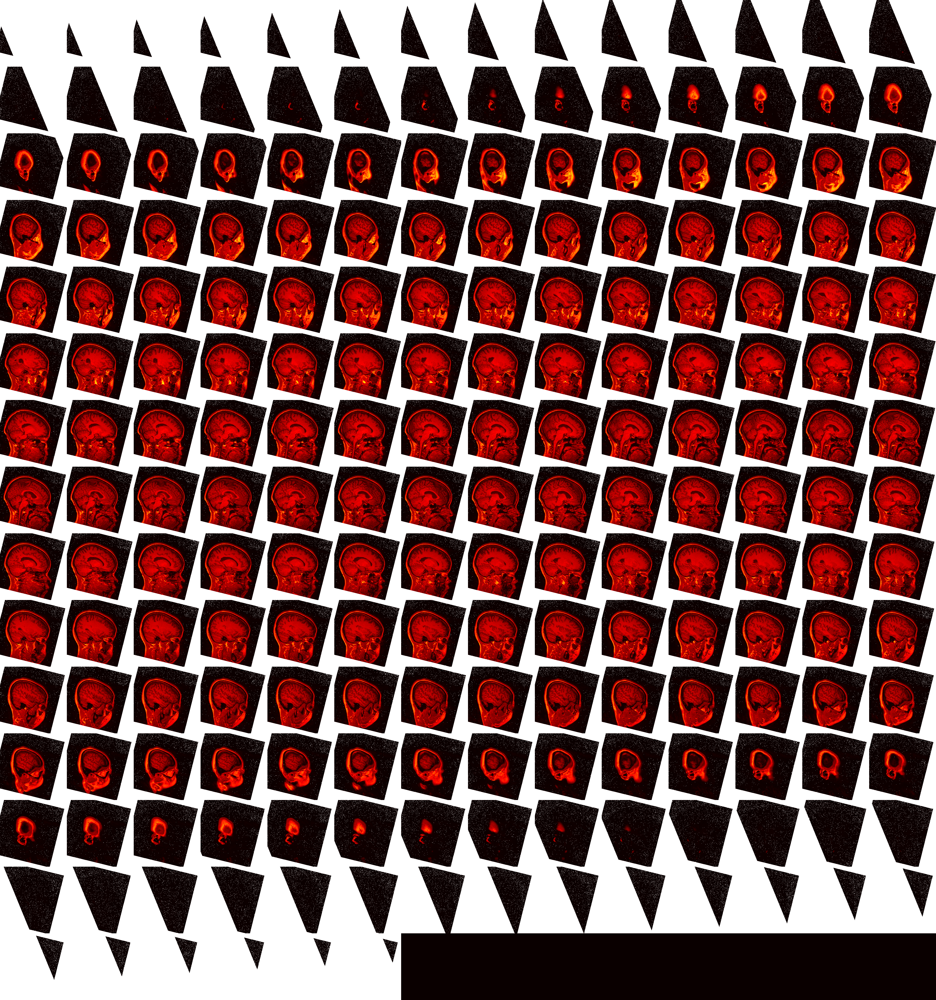

In [113]:
# Load data from a second subject
img2 = nib.load("../Data4Labs/BIDS-dir/sub-CON02/ses-control/anat/sub-CON02_ses-control_T1w.nii.gz")
header2, affine2, data2 = img2.header, img2.affine, img2.get_fdata()

plotting.view_img(
    img1, bg_img=img2, opacity=.4,
    colorbar=False, cmap='hot', symmetric_cmap=False
)

As you can see, the two scanners do not overlay between themselves. You may ask the question, "why?" but the answer might not be trivial. A better question is the same one we have asked before: *Why is nilearn using the whole NIFTI object instead of the data to do the plotting?* Let's take a closer look at properties of the objects we have just plotted.

In [114]:
print("Affine from sub-CON01")
print(affine1)
print("==============================================")
print("Affine from sub-CON02")
print(affine2)

Affine from sub-CON01
[[ 9.93575573e-01  9.12692249e-02  6.69185743e-02 -1.07918091e+02]
 [-1.04696110e-01  9.65790093e-01  2.37251490e-01 -1.17787430e+02]
 [-4.29755449e-02 -2.42733330e-01  9.69140649e-01 -5.83147583e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
Affine from sub-CON02
[[ 9.97337222e-01  5.32575697e-02 -4.97353673e-02 -8.79803696e+01]
 [-4.98367734e-02  9.96463418e-01  6.76527098e-02 -8.78155518e+01]
 [ 5.31622656e-02 -6.49941936e-02  9.96468544e-01 -1.06198227e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


What was the image affine codifying? Exactly! The spatial coordinates of each voxel. Let us discover the spatial position of voxel $(60,140,140)$ for each one of the scans. To do so, we simply multiply the affine with the coordinates in voxel space:

In [115]:
voxel = np.array([60,140,140,1]) # Number 1 is for matrix multiplication
xyz_1 = affine1 @ voxel
xyz_2 = affine2 @ voxel
print("Cartesian coordinates in mm for image 1: ", xyz_1[:-1])
print("Cartesian coordinates in mm for image 2: ", xyz_2[:-1])

Cartesian coordinates in mm for image 1:  [-26.15726456  44.35662526  40.80373371]
Cartesian coordinates in mm for image 2:  [-27.64702791  58.17049973  27.39791806]


It is not surprising that the overlay between the two subjects was not good. Each scan was in its own space (i.e., subject space). Comparing subjects and images is not as straightforward as plotting them together!

All these plots and inspections can be done much easier and (probably) faster with neuroimaging softwares like [FSL](https://fsl.fmrib.ox.ac.uk/fsl/fslwiki), [MRtrix](https://www.mrtrix.org/), [ANTs](https://www.nitrc.org/projects/ants) or [3Dslicer](https://www.slicer.org/). When it comes to plain visualization of nifti objects, it is recommended to have at least one of these three available. In fact, FSL or MRtrix incorporate a lot of useful tools for working with neuroimaging data including but not limited to co-registration and segmentation algorithms. Some of them have overlapping methods while some other have unique software capabilities. Except for 3D slicer, LINUX is the recommended operating system.

## 3. Image registration and tissue segmentation: Unsupervised vs supervised methods

FSL fast and flirt? ANTs? These are softwares that might be cumbersome to install for everybody, but nonetheless, they should be explained. And probably a tour guide through the most important FSL features will come in handy.

Data (pre)processing for neuroimaging includes spatial transformation steps.:
- removal of the non-brain matter (i.e., skull stripping)
- alignment for images that are located in different grids to ensure that the same spatial coordinates denote the same brain region in different patients
- segmenting different types of brain tissue (white matter, gray matter and cerebrospinal fluid) - to be able to restrain certain analyses for specific tissues
- a denoising technique known as removal of bias field homogeneities

Such steps are typically performed with specialized neuroimaging software, that provides resonably accurate results for 3d and 4d images. 
Most popular neuroimaging software for running spatial transformations includes FSL, AFNI and ANTs.
                                                                                                                                                                            
In the following cell, we'll see several examples showcasing FSL's functionality, including:
1. bet (Brain Extraction Tool), a commonly used program to perform brain extraction, which is a type of segmentation used to separate brain (gray matter, white matter and CSF) and non-brain matter (skull, neck)
2. fast (FMRIB's Automated Segmentation Tool), which is a popular implementation for segmenting different brain tissues, usually in three classes: gray matter, white matter and CSF; this procedure is typically performed after non-brain matter was removed from the image (after bet)
3. flirt (FMRIB's Linear Registration Tool), which can run rigid body and affine registration between two images; in this example, we'll perform the registration of an atamocal scan to a standard space. Standard space is a population brain (i.e., and "average" brain) that provides a common reference and coordinate space  to be able to combine data from different participants within the same study, or visualize/analyze results across studies.

For each dataset, depending on the quality of the data, you might need to fine tune some parameters for each step. However, as a benchmark, we will use values that have proven to be robust (based on our judgement) and will comment on other options if they fail.

In [165]:
%%bash

# Directory and file names
Postprocessing_dir="./BIDS-dir/derivatives/sub-CON01/ses-control/anat/"
nifti="../Data4Labs/BIDS-dir/sub-CON01/ses-control/anat/sub-CON01_ses-control_T1w.nii.gz"

# Create derivative directory
mkdir -p $Postprocessing_dir

# 1) Display header information
#

# 2) Skull-stripping or brain extraction
masked_brain=$Postprocessing_dir"sub-CON01_ses-control_T1w_brain"
bet $nifti $masked_brain.nii.gz -f .5 -g -.6
bet $masked_brain.nii.gz $masked_brain.nii.gz -f .35 -m

# 3) Tissue segmentation
#fast -n 4 -I 25 -W 25 -H .25 $masked_brain.nii.gz
fast $masked_brain.nii.gz

# 4) Registration to template
reference="../Data4Labs/Utils/MNI152_T1_1mm_brain.nii.gz"
registered=$Postprocessing_dir"sub-CON01_ses-control_T1w_brain_space-MNI152"
transformation=$Postprocessing_dir"sub-CON01_ses-control_matris2MNI152.txt"
#flirt -in $masked_brain.nii.gz -ref $reference -omat $transformation
flirt -in $masked_brain.nii.gz -ref $reference -out $registered -applyxfm -init $transformation


Could not open matrix file ./BIDS-dir/derivatives/sub-CON01/ses-control/anat/sub-CON01_ses-control_matris2MNI152.txt
matrix multiplication: incompatible matrix dimensions: 4x4 and 0x0


To inspect the outputs of each step you can either do it like in this notebook or by typing ```fsleyes``` into you terminal. Once the viewer has opened, drag the images you want to inspect in the black screen. As you will see, this second option is much more convenient!

All of of the previous methods are unsupervised; i.e., they attemp to minimize a cost function defined on properties of the data. Here are a few examples:

* In the case of ```fast```, mixture gaussian models and hidden markov radiant fields (HMRF) are used. Mixture models allow to define a threshold based on the intensity of the pixels. Added to it, HMRF exploit the fact that two neightbouring models are likely to be of the same type. The ```fast``` command automatically corrects for bias field homogeneities (i.e., the image might look brighter in posterior regions of the brain. Don't worry there are plenty of resources where you can find this and more detailed information: [FAST](https://www.youtube.com/watch?v=xnZoJLSiXTU) (or go to the original references!)
* In the case of ```flirt``` the cost function can be the correlation or the mutual information between the two images (amongst others).
* As in many other examples in machine learning, despite being rather obvious for a human, the ```bet``` algorithm is unintuitively complex. It relies on histogram thresholding and iterative surface estimating.

The only way to become profficient with these steps and algorithms is to fight with them and with some data. Feel free to do so! However, for some data it might be difficult. ANTs might provide more accurate solutions but their tools are substantially heavier in terms of computation. Deep learning might also be a valuable tool. Yet, deep learning usually requires supervised methods with ground-truth labels. Potentially problematic is the "generalizability" of the training and validation dataset. Other possibilities that might improve the final results is the usage of multimodal data.

## 4. Multimodal anatomical MRI acquisition: Lesion segmentation

Anatomical tissue contrast imaging is an efficient and precise way of disinguishing the different types of matter that are present in the (human) brain. There are 4 main types of anatomical modalities:

1. T1-weighted
2. T1-weighted with a contrast agent
3. T2-weighted
4. Fluid Attenuated Imaging Recovery (FLAIR)

![BRATS](./BRATS.jpg)

Sometimes, you might find some people working with the HDF5 format. It works in binary and can store entire datasets. In python, the library is [H5Py](https://docs.h5py.org/en/stable/index.html)